In [3]:
import glob
import time
import tqdm
import os
import sys

import cv2
from matplotlib import pyplot as plt
import numpy as np
sys.path.append("../")

from annoy_utils import AnnoyUtils
from feature_extractor import FeatureExtractor

In [4]:
def show_similar_items(similar_items):
    """Function to show similar_items
            
        Args: 
            similar_items: dict. {'ref_image_path': ['similar_image_path', confidence]}

        Returns: 

    """
    
    cntr = 0

    for key, vals in similar_items.items():
        for val in vals:
            cntr+=1
            img1 = cv2.imread(key) #read reference image
            img2 = cv2.imread(val[0]) #read similar image

            if img2 is None: #if file could be not read!
                print("file not found!")
                plt.imshow(img1[:,:,::-1])
                plt.show()
                continue
                
            #score = val[1]
            print(f"**\nref: {key} \nsimilars: {val}\**")

            img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0])) #resize images for hconcat
            
            combined = cv2.hconcat([img1, img2]) #combine images
            
            #show images
            plt.imshow(combined[:,:,::-1])
            plt.show()

            print("*"*33)
    print(f"{cntr} files detected!")

In [5]:
def remove_similar_items(similar_items, simulate=False):
    """Function to remove similar_items
            
        Args: 
            similar_items: dict. {'ref_image_path': ['similar_image_path', confidence]}

        Returns: 

    """
    cntr = 0

    for key, vals in similar_items.items():
        for val in vals:
            cntr+=1
            if not simulate:
                os.remove(val[0])
    if simulate:
        print(f"{cntr} files WILL BE removed")
    else:
        print(f"{cntr} files removed")

### set parameters

In [6]:
annoy_metric = "angular" # "euclidean", "manhattan", "hamming", "dot"
annoy_vector_length = 4096 #feature length (vgg16)
annoy_n_trees = 50 #More trees gives higher precision when querying -> https://github.com/spotify/annoy

similarity_threshold = 0.1 #0.0 exact match, <0.5 similar images

image_list = glob.glob('/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/*/*')

feature_list = []

In [7]:
print("preparing featureExtractor")
feature_extractor = FeatureExtractor()

preparing featureExtractor
preparing model...


2022-08-30 22:32:52.258705: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


553467096/553467096 [==============================] - 49s 0us/step


In [8]:
print(f"preparing annoy index for {len(image_list)} images")

#init annoy
annoy_utils = AnnoyUtils()
annoy_utils.prepare_annoy(annoy_vector_length, annoy_metric)

#set image_list
annoy_utils.set_image_list(image_list)

preparing annoy index for 6413 images
init annoy_index (vector_length:4096, metric:angular)...
setting image_list. length: 6413


###  extract features and update annoy index

In [10]:
#batch processing
start_time = time.time()

total_size = len(image_list)
batch_size = 64 #mind the memory usage!

ind = 0
for start_index in range(0, total_size, batch_size):
    end_index = total_size if start_index + batch_size > total_size else start_index + batch_size
    batch = image_list[start_index:end_index] 
    
    print(f"processing... {start_index}/{total_size}")
    
    batch_features = feature_extractor.extract_feature_for_batch_images(batch)
    
    for tmp_features in batch_features:
        feature_list.append(tmp_features) #add features to list
        annoy_utils.ann_index.add_item(ind, tmp_features)
        ind+=1

#print("building index..")
annoy_utils.build_index(annoy_n_trees)

#print("saving index..")
annoy_utils.save_index('annoy.index')

print("it took {:.2f} seconds to build index for {} images".format(time.time()-start_time, total_size))

processing... 0/6413
processing... 64/6413
processing... 128/6413
processing... 192/6413
processing... 256/6413
processing... 320/6413
processing... 384/6413
processing... 448/6413
processing... 512/6413
processing... 576/6413
processing... 640/6413
processing... 704/6413
processing... 768/6413
processing... 832/6413
processing... 896/6413
processing... 960/6413
processing... 1024/6413
processing... 1088/6413
processing... 1152/6413
processing... 1216/6413
processing... 1280/6413
processing... 1344/6413
processing... 1408/6413
processing... 1472/6413
processing... 1536/6413
processing... 1600/6413
processing... 1664/6413
processing... 1728/6413
processing... 1792/6413
processing... 1856/6413
processing... 1920/6413
processing... 1984/6413
processing... 2048/6413
processing... 2112/6413
processing... 2176/6413
processing... 2240/6413
processing... 2304/6413
processing... 2368/6413
processing... 2432/6413
processing... 2496/6413
processing... 2560/6413
processing... 2624/6413
processing.

## analyze and find similar images

In [11]:
similar_items = {}

processed_items = []
retrieve_n_most_similar=9999

for ind, (image_path, tmp_features) in tqdm.tqdm_notebook(enumerate(zip(image_list,feature_list))):

    if image_path in processed_items:
        continue
    processed_items.append(image_path)

    most_similars = annoy_utils.query_similar_images_by_features(tmp_features, retrieve_n_most_similar)
    
    for sim_image_ind, confidence  in most_similars:
        similar_image_path = image_list[sim_image_ind]
        
        if similar_image_path == image_path or similar_image_path in processed_items:
            continue

        if confidence < similarity_threshold: #0.0 exact match, <0.5 similar images
            if image_path in similar_items:
                similar_items[image_path].append([similar_image_path, confidence])
            else:
                similar_items[image_path] = []
                similar_items[image_path].append([similar_image_path, confidence])
            processed_items.append(similar_image_path)

/var/folders/q6/q79s9ywn0k3d66m8c2n81nz40000gn/T/ipykernel_4447/287639675.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for ind, (image_path, tmp_features) in tqdm.tqdm_notebook(enumerate(zip(image_list,feature_list))):


0it [00:00, ?it/s]

## show samples

**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/028__10 Sentimos_philippines.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/035__10 Sentimos_philippines.jpg', 0.0]\**


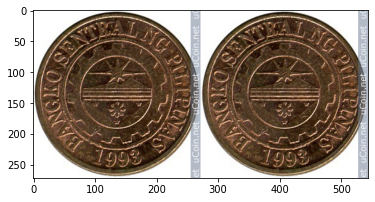

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/026__10 Sentimos_philippines.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/031__10 Sentimos_philippines.jpg', 4.558956788969226e-05]\**


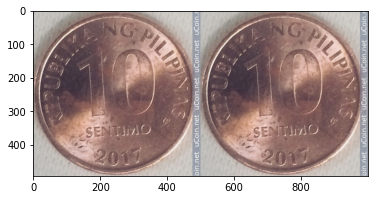

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/002__10 Sentimos_philippines.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/010__10 Sentimos_philippines.jpg', 0.00048763619270175695]\**


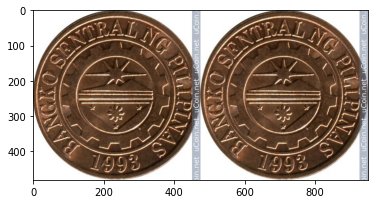

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/002__10 Sentimos_philippines.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/016__10 Sentimos_philippines.jpg', 0.00048763619270175695]\**


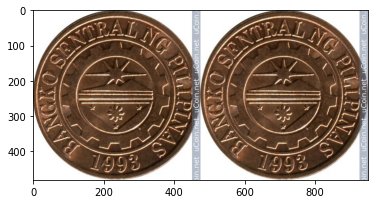

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/002__10 Sentimos_philippines.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/013__10 Sentimos_philippines.jpg', 0.07272554934024811]\**


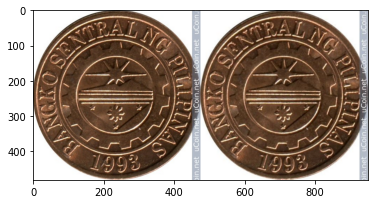

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/009__10 Sentimos_philippines.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/135/024__10 Sentimos_philippines.jpg', 0.0003901139716617763]\**


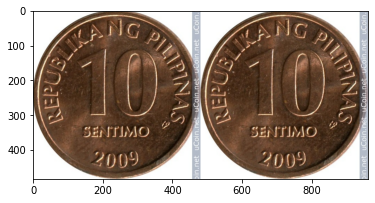

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/004__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/019__2 Euro_spain.jpg', 0.00021800021931994706]\**


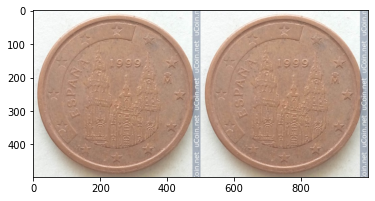

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/004__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/019__2 euro Cent_spain.jpg', 0.00021800021931994706]\**


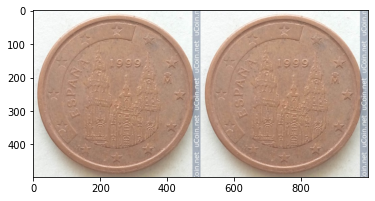

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/001__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/001__2 euro Cent_spain.jpg', 0.0]\**


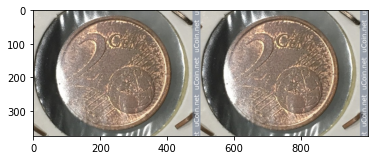

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/029__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/031__2 euro Cent_spain.jpg', 0.0]\**


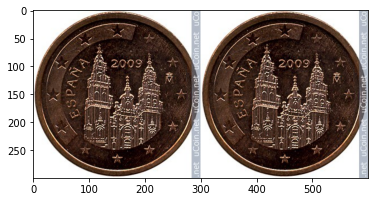

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/006__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/004__2 euro Cent_spain.jpg', 0.0]\**


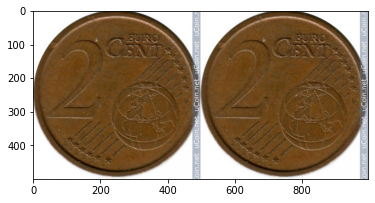

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/003__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/013__2 euro Cent_spain.jpg', 0.0001315865374635905]\**


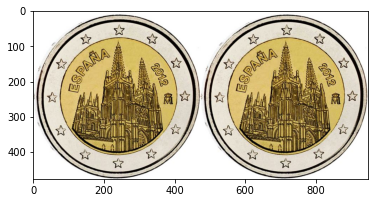

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/007__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/005__2 euro Cent_spain.jpg', 0.0002976398100145161]\**


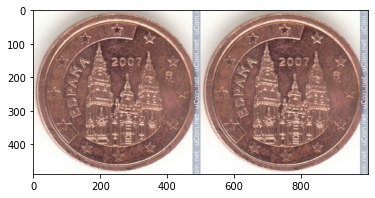

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/012__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/027__2 Euro_spain.jpg', 0.00020342928473837674]\**


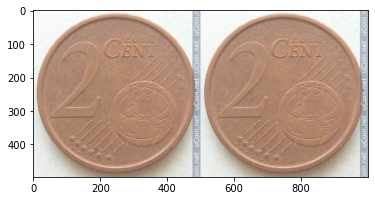

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/012__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/012__2 euro Cent_spain.jpg', 0.00020342928473837674]\**


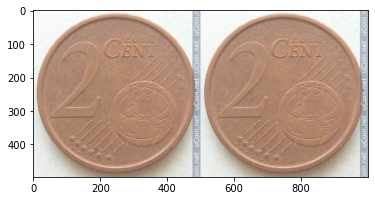

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/012__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/029__2 euro Cent_spain.jpg', 0.00020342928473837674]\**


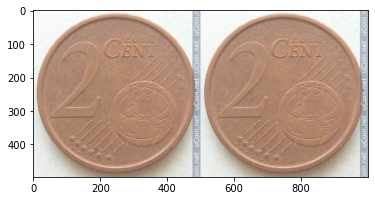

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/022__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/023__2 euro Cent_spain.jpg', 0.00036777497734874487]\**


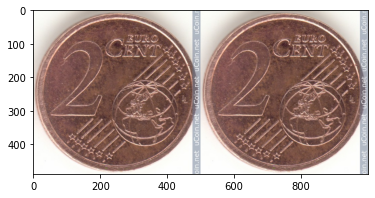

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/015__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/014__2 euro Cent_spain.jpg', 0.0]\**


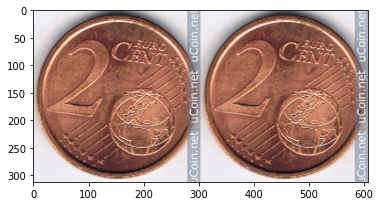

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/021__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/021__2 euro Cent_spain.jpg', 0.00026054904446937144]\**


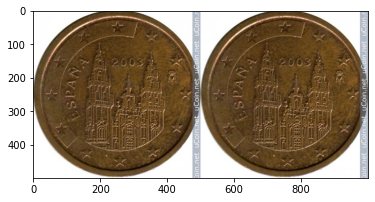

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/009__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/007__2 euro Cent_spain.jpg', 0.0]\**


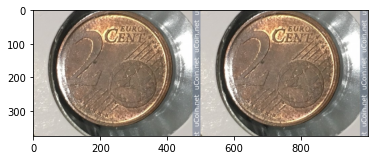

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/010__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/008__2 euro Cent_spain.jpg', 0.0]\**


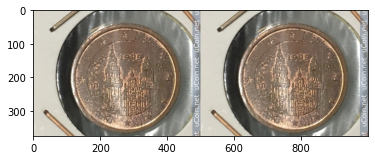

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/008__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/006__2 euro Cent_spain.jpg', 0.0001501998194726184]\**


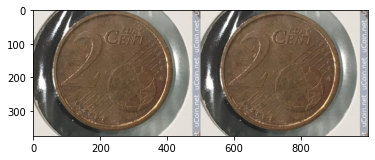

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/61/011__2 Euro_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/55/011__2 euro Cent_spain.jpg', 0.00020724115893244743]\**


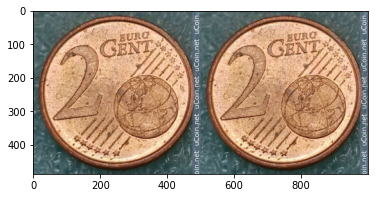

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/95/030__10 Yen_japan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/95/036__10 Yen_japan.jpg', 0.0]\**


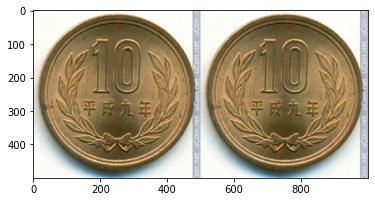

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/95/028__10 Yen_japan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/95/016__10 Yen_japan.jpg', 0.00015218408952932805]\**


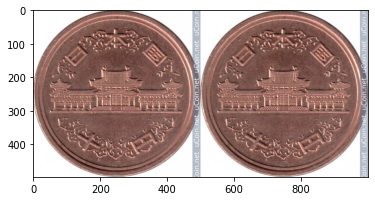

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/95/007__10 Yen_japan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/95/015__10 Yen_japan.jpg', 0.0]\**


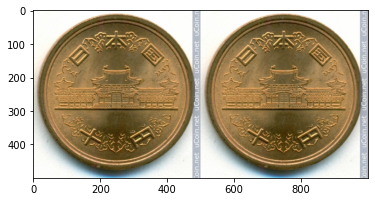

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/002__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/020__10 Rupees_pakistan.jpg', 0.0]\**


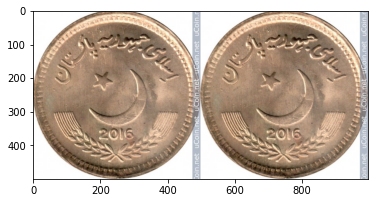

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/002__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/023__10 Rupees_pakistan.jpg', 0.0]\**


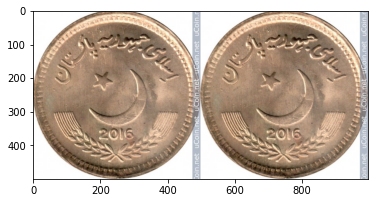

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/002__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/001__10 Rupees_pakistan.jpg', 0.0]\**


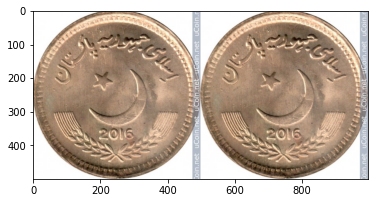

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/002__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/032__10 Rupees_pakistan.jpg', 0.0]\**


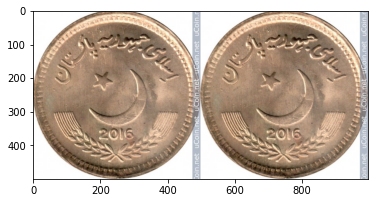

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/002__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/025__10 Rupees_pakistan.jpg', 0.0]\**


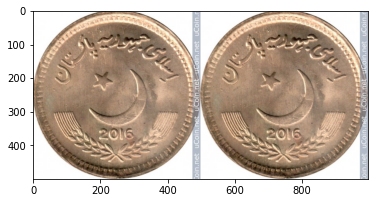

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/002__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/007__10 Rupees_pakistan.jpg', 0.0]\**


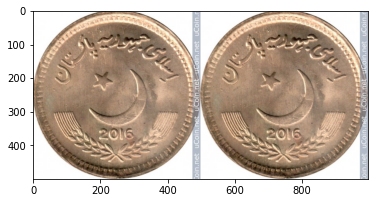

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/002__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/004__10 Rupees_pakistan.jpg', 0.0]\**


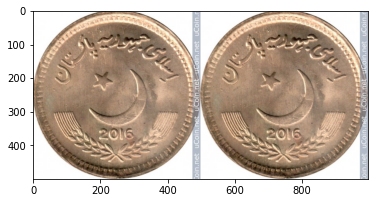

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/002__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/017__10 Rupees_pakistan.jpg', 0.0]\**


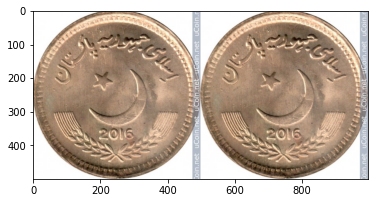

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/002__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/013__10 Rupees_pakistan.jpg', 0.0]\**


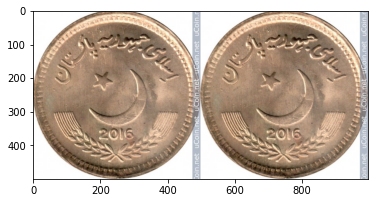

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/011__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/028__10 Rupees_pakistan.jpg', 0.0]\**


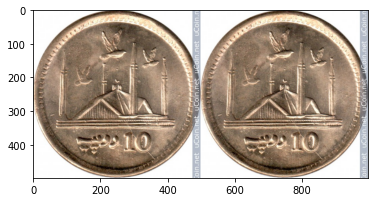

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/011__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/034__10 Rupees_pakistan.jpg', 0.0]\**


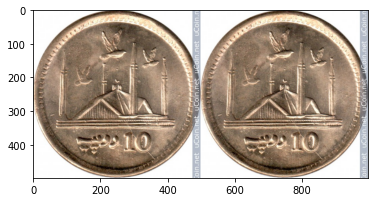

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/011__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/026__10 Rupees_pakistan.jpg', 0.0]\**


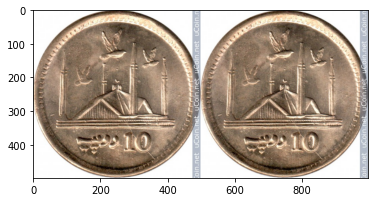

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/011__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/018__10 Rupees_pakistan.jpg', 0.0]\**


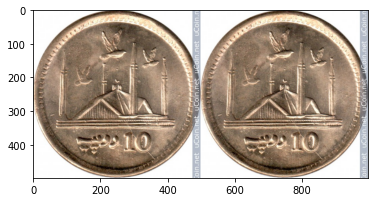

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/011__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/022__10 Rupees_pakistan.jpg', 0.0]\**


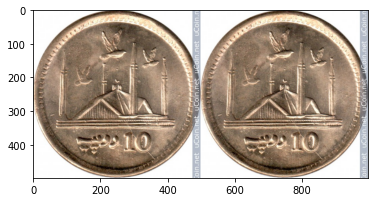

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/132/012__10 Rupees_pakistan.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/131/002__5 Rupees_pakistan.jpg', 0.0]\**


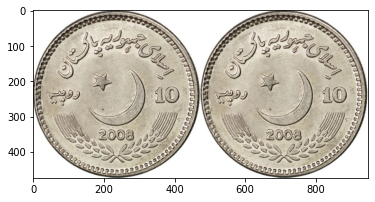

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/59/007__50 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/59/009__50 euro Cent_spain.jpg', 0.0003066302160732448]\**


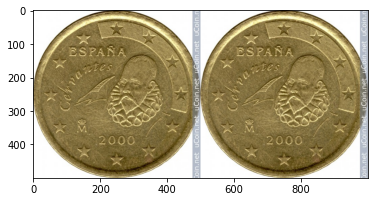

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/59/032__50 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/59/021__50 euro Cent_spain.jpg', 0.0]\**


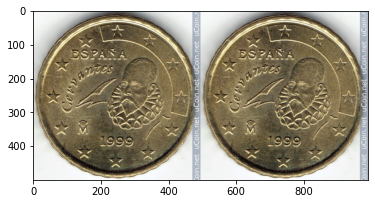

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/59/026__50 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/59/029__50 euro Cent_spain.jpg', 0.00017697879229672253]\**


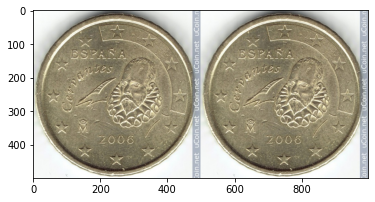

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/59/017__50 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/59/023__50 euro Cent_spain.jpg', 0.00032760968315415084]\**


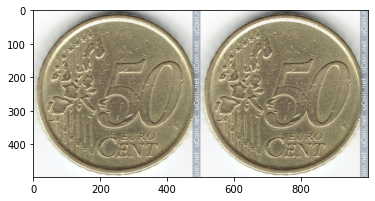

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/59/034__50 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/59/019__50 euro Cent_spain.jpg', 0.00024506993941031396]\**


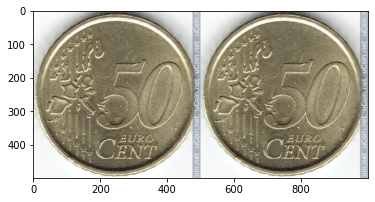

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/005__10 New Sheqalim_israel.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/024__10 New Sheqalim_israel.jpg', 0.00043618804193101823]\**


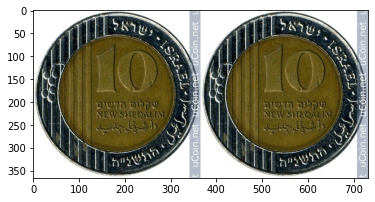

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/005__10 New Sheqalim_israel.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/010__10 New Sheqalim_israel.jpg', 0.00043618804193101823]\**


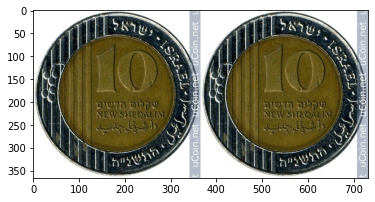

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/013__10 New Sheqalim_israel.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/012__10 New Sheqalim_israel.jpg', 0.0]\**


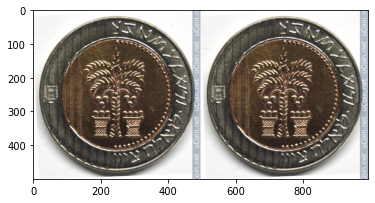

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/029__10 New Sheqalim_israel.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/034__10 New Sheqalim_israel.jpg', 0.0004235680971760303]\**


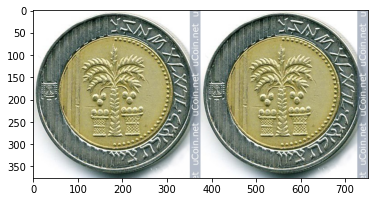

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/022__10 New Sheqalim_israel.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/018__10 New Sheqalim_israel.jpg', 0.00032722801552154124]\**


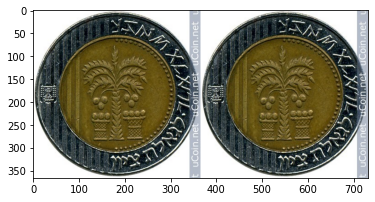

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/022__10 New Sheqalim_israel.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/006__10 New Sheqalim_israel.jpg', 0.00032722801552154124]\**


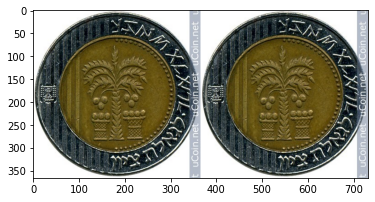

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/011__10 New Sheqalim_israel.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/92/003__10 New Sheqalim_israel.jpg', 0.0003217530611436814]\**


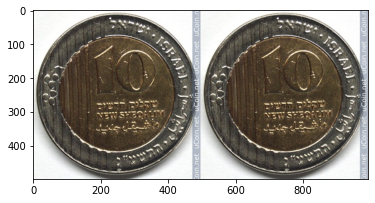

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/004__5 Dollars_hong_kong.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/028__5 Dollars_hong_kong.jpg', 0.0004893444711342454]\**


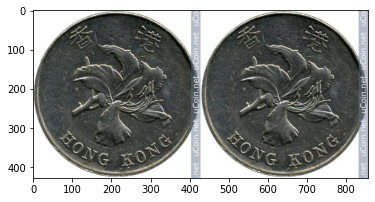

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/029__5 Dollars_hong_kong.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/030__5 Dollars_hong_kong.jpg', 0.00022357348643708974]\**


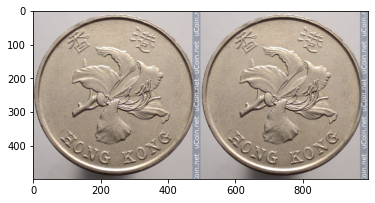

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/029__5 Dollars_hong_kong.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/027__5 Dollars_hong_kong.jpg', 0.00022357348643708974]\**


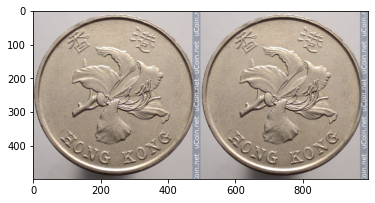

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/021__5 Dollars_hong_kong.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/012__5 Dollars_hong_kong.jpg', 6.848363409517333e-05]\**


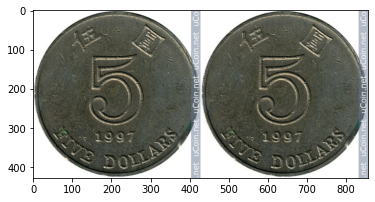

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/021__5 Dollars_hong_kong.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/018__5 Dollars_hong_kong.jpg', 6.848363409517333e-05]\**


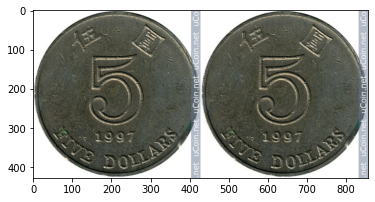

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/001__5 Dollars_hong_kong.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/032__5 Dollars_hong_kong.jpg', 0.0]\**


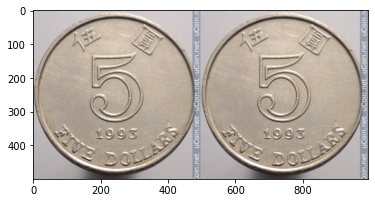

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/001__5 Dollars_hong_kong.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/015__5 Dollars_hong_kong.jpg', 0.0]\**


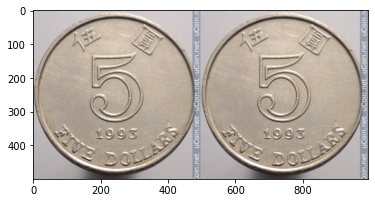

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/001__5 Dollars_hong_kong.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/002__5 Dollars_hong_kong.jpg', 0.0]\**


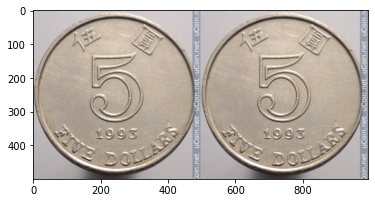

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/005__5 Dollars_hong_kong.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/010__5 Dollars_hong_kong.jpg', 0.0]\**


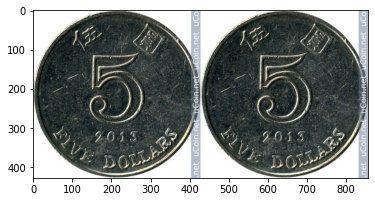

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/003__5 Dollars_hong_kong.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/66/023__5 Dollars_hong_kong.jpg', 0.0002623818872962147]\**


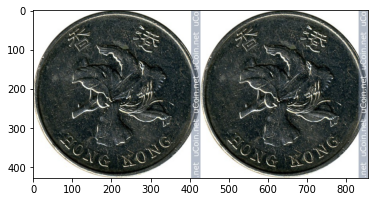

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/029__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/028__2 Kroner_denmark.jpg', 8.16614119685255e-05]\**


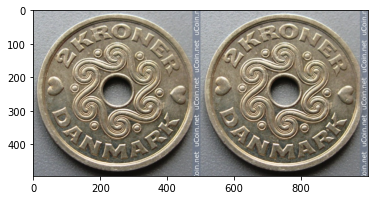

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/005__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/011__2 Kroner_denmark.jpg', 0.0003364599251653999]\**


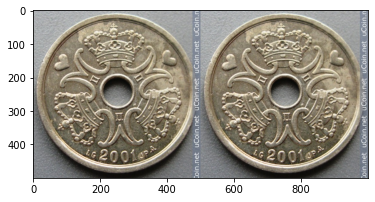

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/021__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/024__2 Kroner_denmark.jpg', 0.00033016919041983783]\**


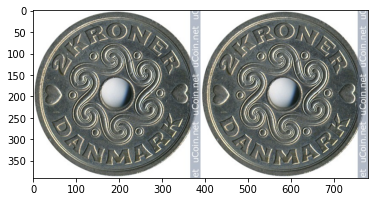

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/007__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/53/013__20 Kroner_denmark.jpg', 0.00040804699528962374]\**


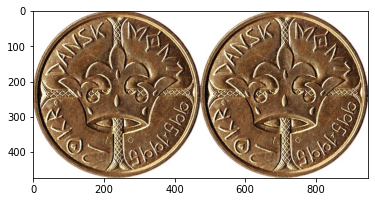

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/025__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/53/002__20 Kroner_denmark.jpg', 0.00039940321585163474]\**


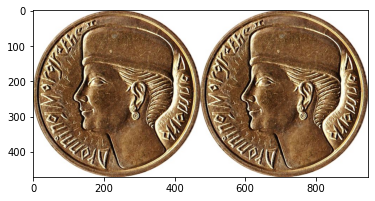

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/009__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/006__2 Kroner_denmark.jpg', 0.0]\**


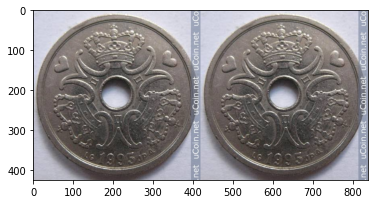

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/017__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/49/030__1 Krone_denmark.jpg', 0.0003365201991982758]\**


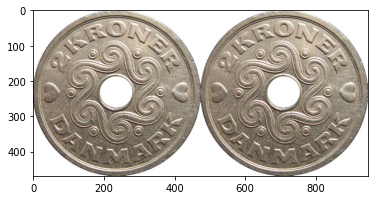

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/027__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/51/003__5 Kroner_denmark.jpg', 0.0]\**


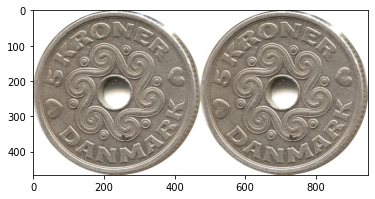

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/027__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/52/008__10 Kroner_denmark.jpg', 0.0]\**


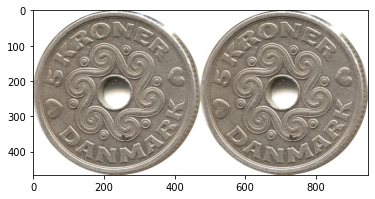

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/027__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/49/026__1 Krone_denmark.jpg', 0.0]\**


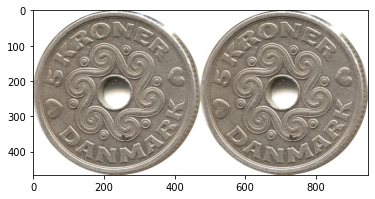

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/012__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/034__2 Kroner_denmark.jpg', 0.00021726617706008255]\**


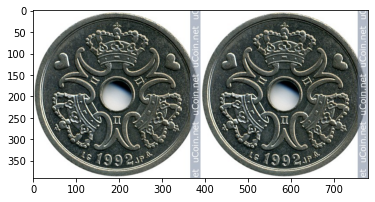

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/012__2 Kroner_denmark.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/50/030__2 Kroner_denmark.jpg', 0.00021726617706008255]\**


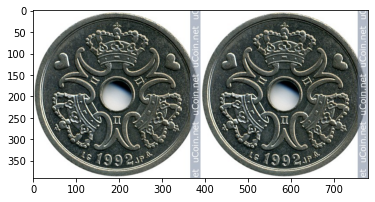

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/034__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/004__2 Forint_hungary.jpg', 0.0]\**


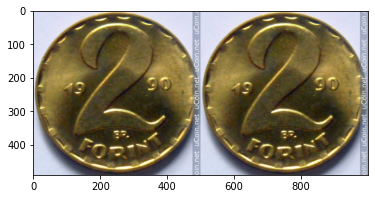

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/034__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/036__2 Forint_hungary.jpg', 0.0]\**


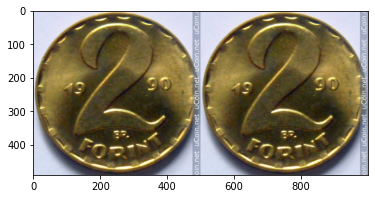

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/034__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/008__2 Forint_hungary.jpg', 0.0]\**


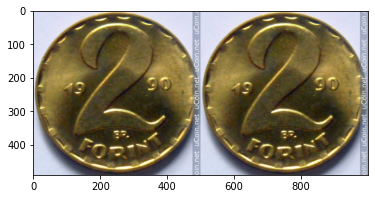

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/034__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/035__2 Forint_hungary.jpg', 0.0]\**


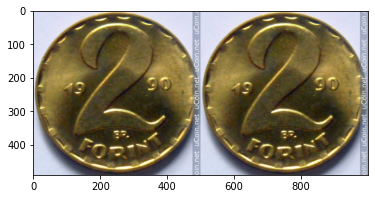

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/034__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/023__2 Forint_hungary.jpg', 0.0]\**


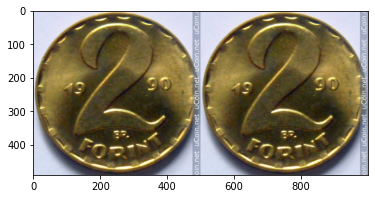

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/034__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/015__2 Forint_hungary.jpg', 0.0]\**


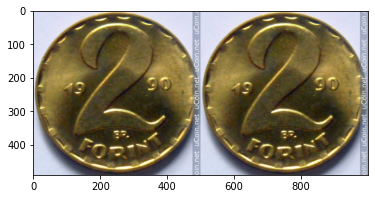

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/034__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/001__2 Forint_hungary.jpg', 0.0]\**


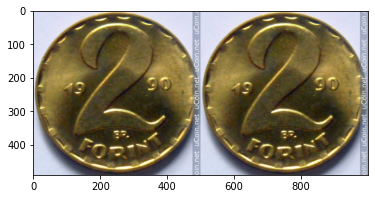

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/034__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/033__2 Forint_hungary.jpg', 0.0]\**


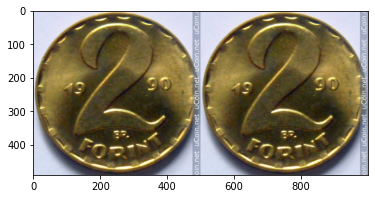

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/012__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/026__2 Forint_hungary.jpg', 0.0001534584298497066]\**


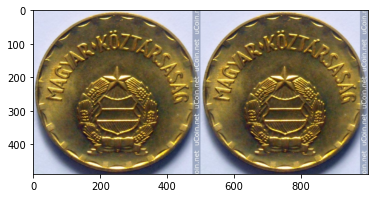

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/012__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/014__2 Forint_hungary.jpg', 0.0001534584298497066]\**


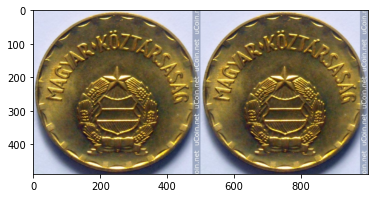

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/012__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/024__2 Forint_hungary.jpg', 0.0001534584298497066]\**


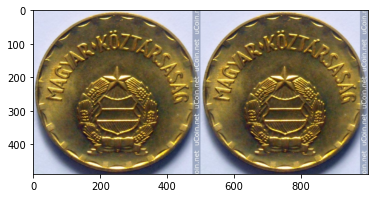

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/012__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/029__2 Forint_hungary.jpg', 0.0001534584298497066]\**


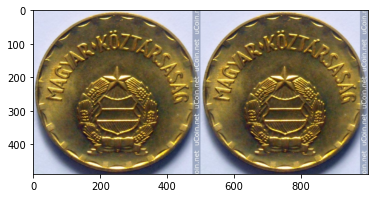

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/012__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/017__2 Forint_hungary.jpg', 0.0001534584298497066]\**


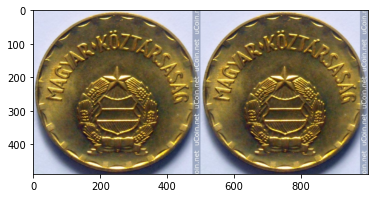

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/012__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/009__2 Forint_hungary.jpg', 0.0001534584298497066]\**


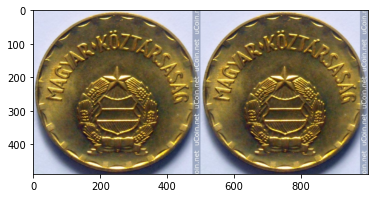

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/012__2 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/68/025__2 Forint_hungary.jpg', 0.0001534584298497066]\**


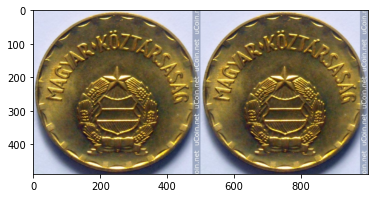

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/103/032__100 Won_south_korea.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/99/028__1 Won_south_korea.jpg', 0.0002694841823540628]\**


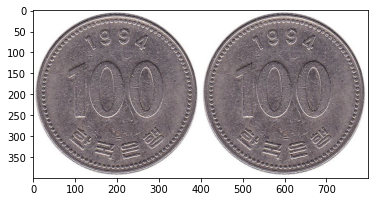

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/013__10 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/006__10 euro Cent_spain.jpg', 0.0003347317106090486]\**


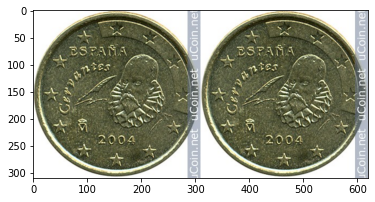

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/035__10 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/028__10 euro Cent_spain.jpg', 0.0]\**


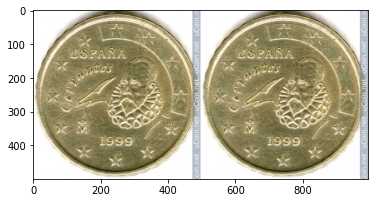

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/029__10 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/54/032__1 euro Cent_spain.jpg', 0.0006228957208804786]\**


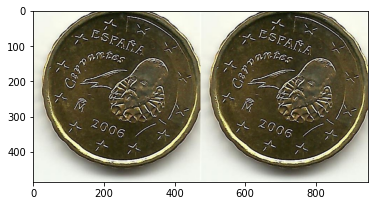

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/017__10 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/010__10 euro Cent_spain.jpg', 0.00030566222267225385]\**


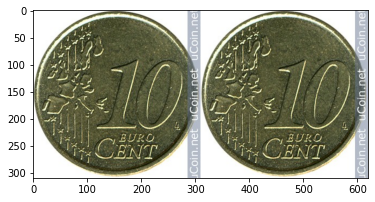

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/018__10 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/002__10 euro Cent_spain.jpg', 0.00017828465206548572]\**


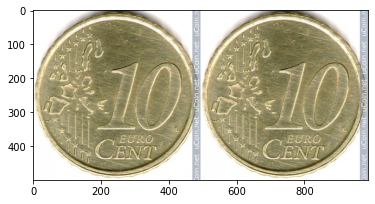

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/025__10 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/027__10 euro Cent_spain.jpg', 0.0004356773570179939]\**


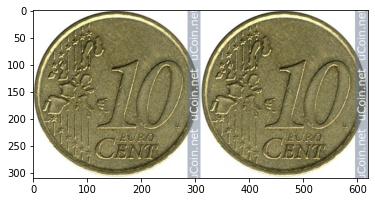

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/030__10 euro Cent_spain.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/57/033__10 euro Cent_spain.jpg', 0.0]\**


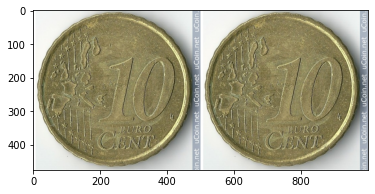

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/008__1 Rand_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/013__1 Rand_south_africa.jpg', 0.0004162545665167272]\**


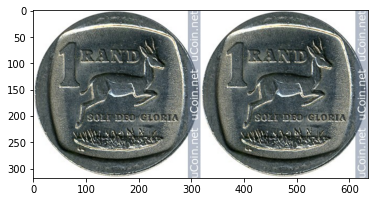

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/016__1 Rand_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/021__1 Rand_south_africa.jpg', 0.0004744722682517022]\**


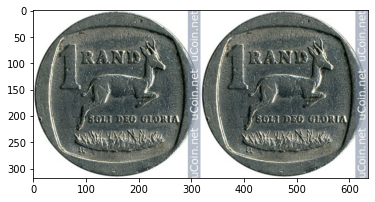

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/016__1 Rand_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/025__1 Rand_south_africa.jpg', 0.0004744722682517022]\**


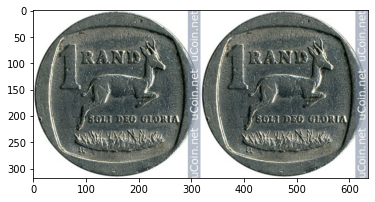

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/016__1 Rand_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/036__1 Rand_south_africa.jpg', 0.0004744722682517022]\**


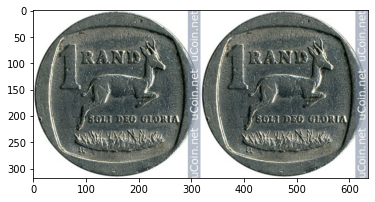

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/016__1 Rand_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/018__1 Rand_south_africa.jpg', 0.0004744722682517022]\**


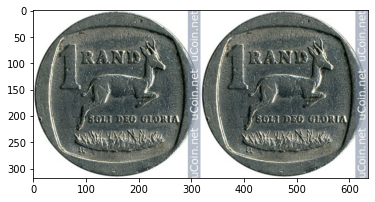

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/012__1 Rand_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/028__1 Rand_south_africa.jpg', 0.00030948378844186664]\**


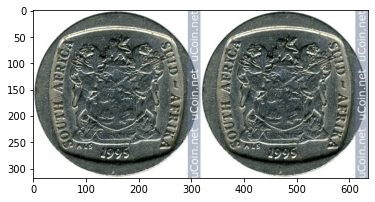

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/012__1 Rand_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/003__1 Rand_south_africa.jpg', 0.00030948378844186664]\**


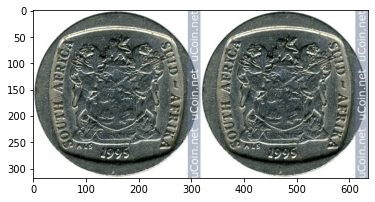

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/024__1 Rand_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/023__1 Rand_south_africa.jpg', 0.0]\**


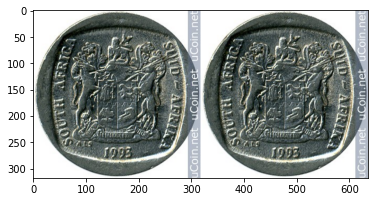

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/005__1 Rand_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/007__1 Rand_south_africa.jpg', 0.0]\**


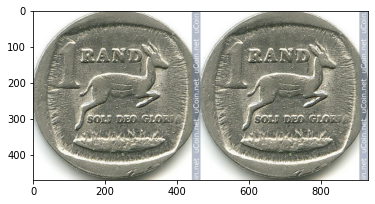

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/015__1 Rand_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/168/035__1 Rand_south_africa.jpg', 0.0]\**


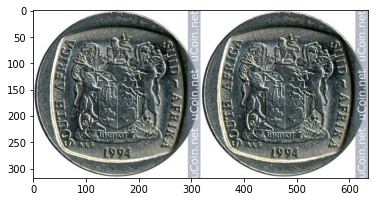

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/012__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/001__1 Cent_singapore.jpg', 7.901265053078532e-05]\**


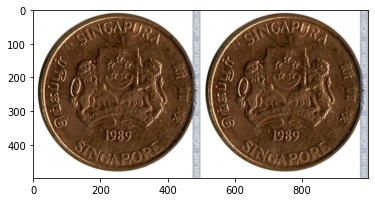

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/012__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/025__1 Cent_singapore.jpg', 7.901265053078532e-05]\**


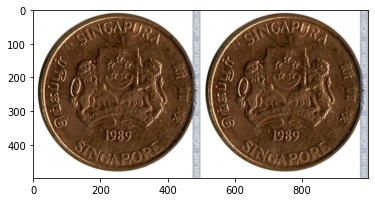

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/036__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/010__1 Cent_singapore.jpg', 0.0]\**


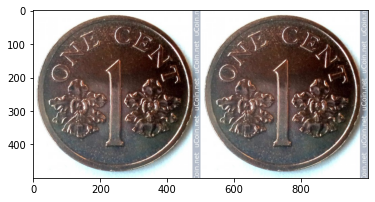

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/036__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/024__1 Cent_singapore.jpg', 0.0]\**


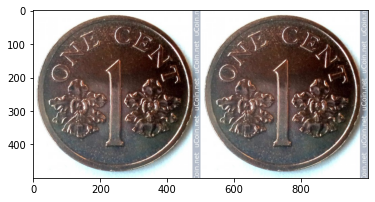

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/036__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/026__1 Cent_singapore.jpg', 0.0]\**


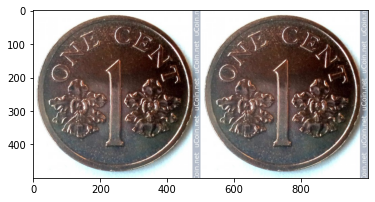

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/036__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/007__1 Cent_singapore.jpg', 0.0]\**


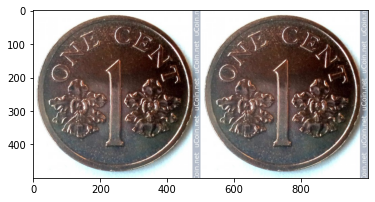

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/036__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/027__1 Cent_singapore.jpg', 0.0]\**


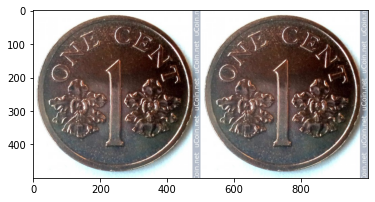

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/020__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/018__1 Cent_singapore.jpg', 0.0003000119759235531]\**


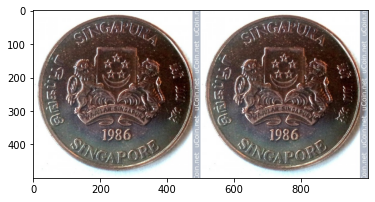

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/020__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/023__1 Cent_singapore.jpg', 0.0003000119759235531]\**


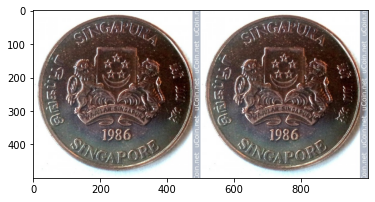

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/020__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/035__1 Cent_singapore.jpg', 0.0003000119759235531]\**


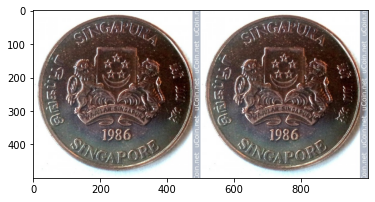

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/020__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/019__1 Cent_singapore.jpg', 0.0003000119759235531]\**


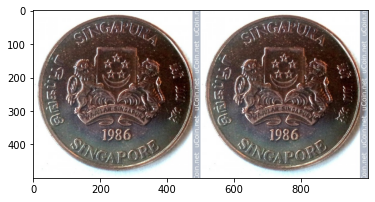

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/017__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/033__1 Cent_singapore.jpg', 0.0003383076982572675]\**


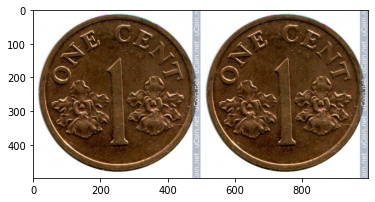

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/017__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/003__1 Cent_singapore.jpg', 0.0003383076982572675]\**


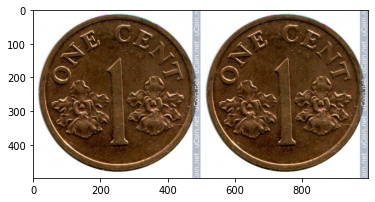

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/017__1 Cent_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/157/031__1 Cent_singapore.jpg', 0.0003383076982572675]\**


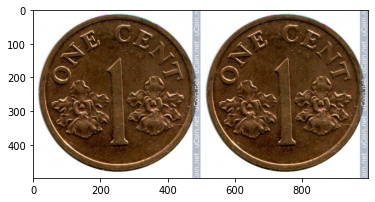

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/150/033__5 Kopeks_russia.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/150/008__5 Kopeks_russia.jpg', 0.0003541709447745234]\**


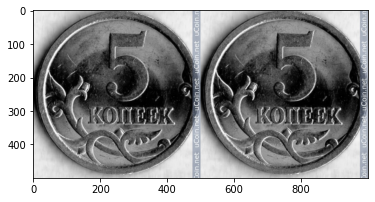

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/150/021__5 Kopeks_russia.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/150/022__5 Kopeks_russia.jpg', 0.00027859469992108643]\**


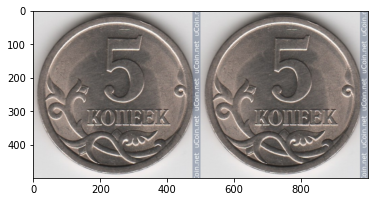

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/150/013__5 Kopeks_russia.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/150/007__5 Kopeks_russia.jpg', 0.0001416282611899078]\**


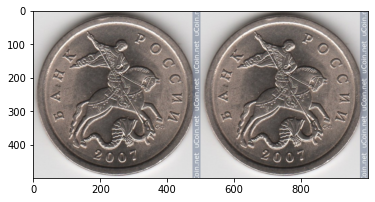

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/028__10 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/016__10 Cents_singapore.jpg', 0.0]\**


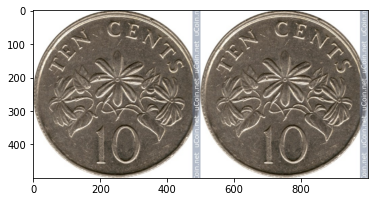

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/028__10 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/024__10 Cents_singapore.jpg', 0.0]\**


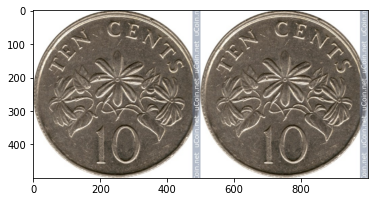

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/027__10 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/009__10 Cents_singapore.jpg', 0.0]\**


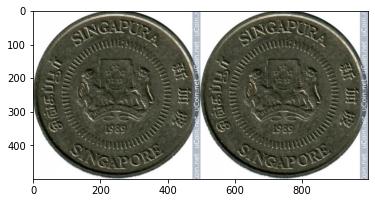

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/027__10 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/006__10 Cents_singapore.jpg', 0.0]\**


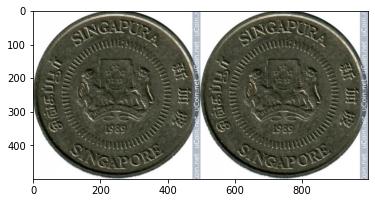

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/027__10 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/025__10 Cents_singapore.jpg', 0.0]\**


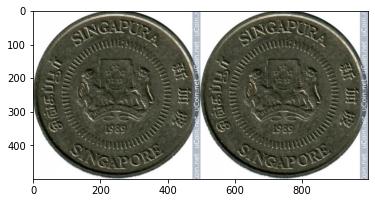

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/005__10 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/004__10 Cents_singapore.jpg', 0.0001592525077285245]\**


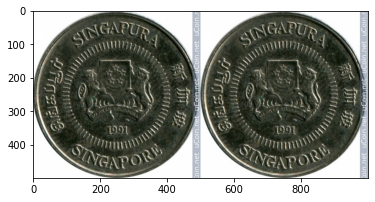

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/023__10 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/010__10 Cents_singapore.jpg', 0.0005386825068853796]\**


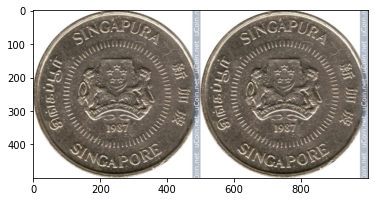

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/011__10 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/013__10 Cents_singapore.jpg', 0.00013733882224187255]\**


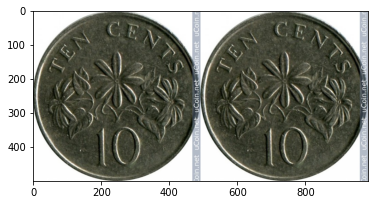

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/011__10 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/035__10 Cents_singapore.jpg', 0.00013733882224187255]\**


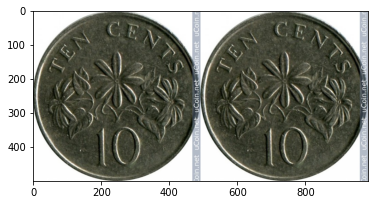

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/011__10 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/159/003__10 Cents_singapore.jpg', 0.00013733882224187255]\**


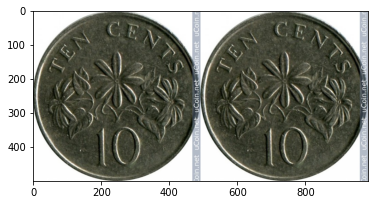

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/060__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/019__50 Pesos_chile.jpg', 0.0]\**


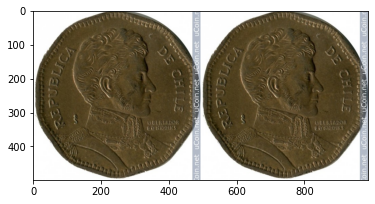

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/030__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/004__50 Pesos_chile.jpg', 0.0005006524734199047]\**


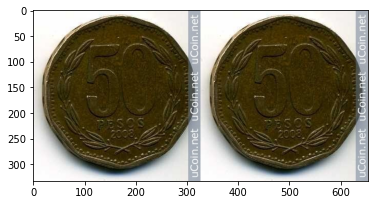

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/029__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/025__50 Pesos_chile.jpg', 0.0]\**


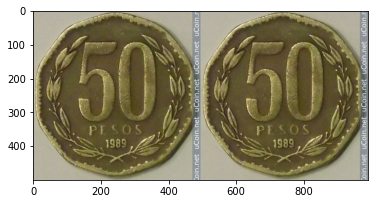

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/034__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/035__50 Pesos_chile.jpg', 0.0]\**


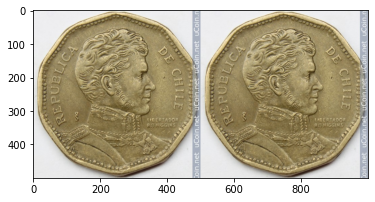

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/034__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/047__50 Pesos_chile.jpg', 0.0]\**


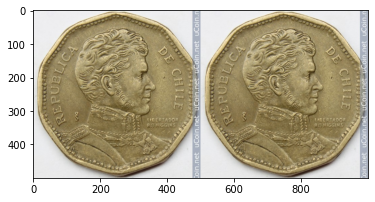

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/034__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/040__50 Pesos_chile.jpg', 0.0]\**


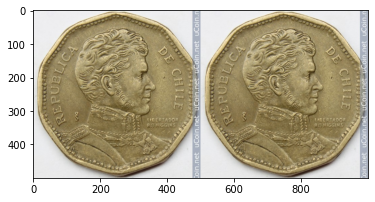

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/037__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/006__50 Pesos_chile.jpg', 0.00025916859158314764]\**


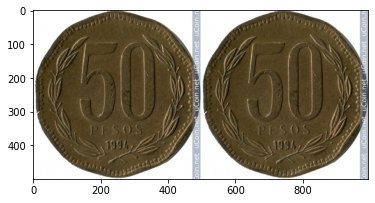

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/021__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/018__50 Pesos_chile.jpg', 0.00023909847368486226]\**


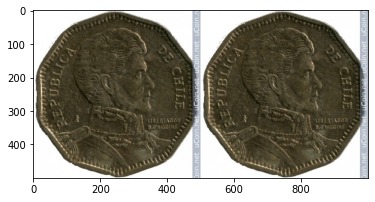

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/039__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/015__50 Pesos_chile.jpg', 0.0]\**


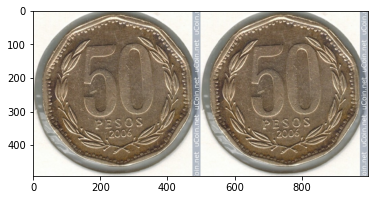

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/044__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/003__50 Pesos_chile.jpg', 0.00023003896058071405]\**


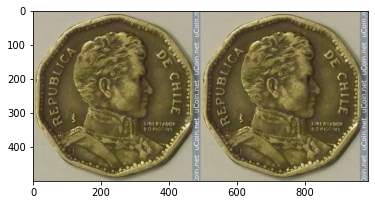

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/014__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/053__50 Pesos_chile.jpg', 0.0003504204214550555]\**


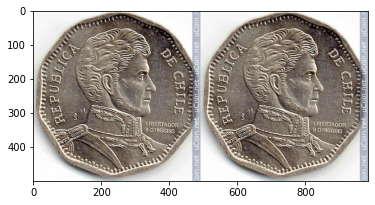

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/045__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/013__50 Pesos_chile.jpg', 0.0]\**


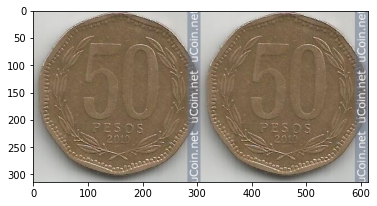

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/017__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/042__50 Pesos_chile.jpg', 3.4791348298313096e-05]\**


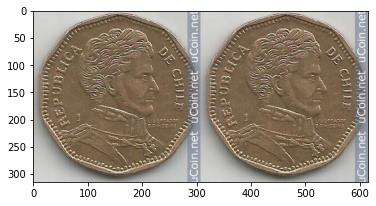

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/016__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/012__50 Pesos_chile.jpg', 0.0003171126008965075]\**


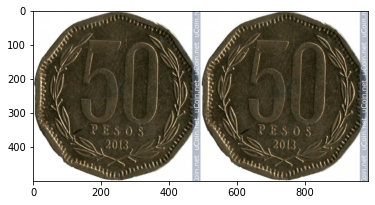

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/058__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/010__50 Pesos_chile.jpg', 0.0001321859599556774]\**


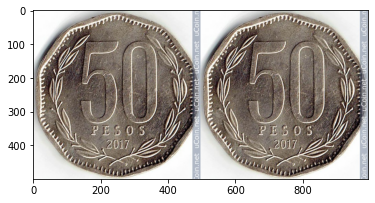

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/011__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/057__50 Pesos_chile.jpg', 0.0]\**


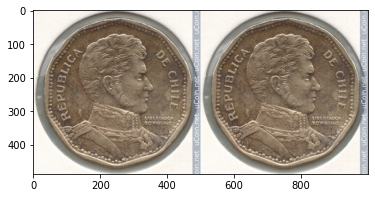

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/056__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/001__50 Pesos_chile.jpg', 0.00017163065786007792]\**


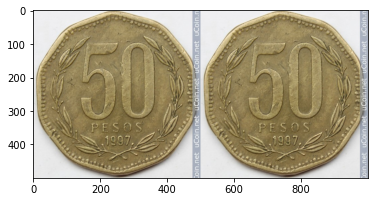

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/056__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/049__50 Pesos_chile.jpg', 0.00017163065786007792]\**


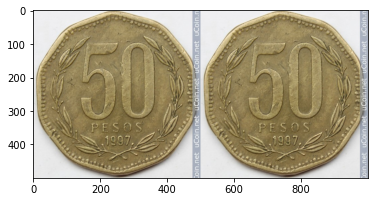

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/054__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/055__50 Pesos_chile.jpg', 0.00020998540276195854]\**


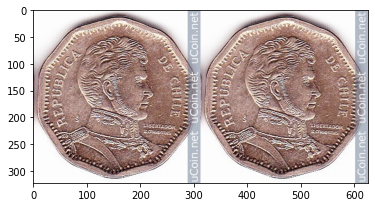

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/052__50 Pesos_chile.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/32/050__50 Pesos_chile.jpg', 0.0004437678144313395]\**


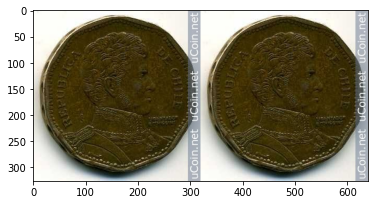

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/166/021__20 Cents_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/166/034__20 Cents_south_africa.jpg', 0.0]\**


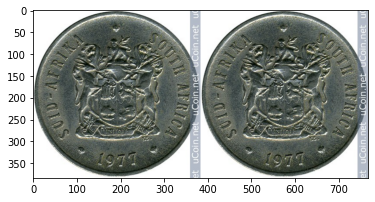

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/166/002__20 Cents_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/166/019__20 Cents_south_africa.jpg', 0.00033454920048825443]\**


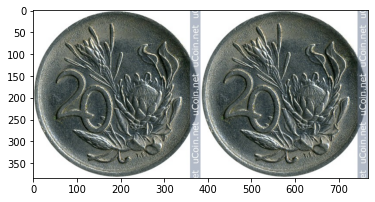

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/166/003__20 Cents_south_africa.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/166/023__20 Cents_south_africa.jpg', 0.0004215515509713441]\**


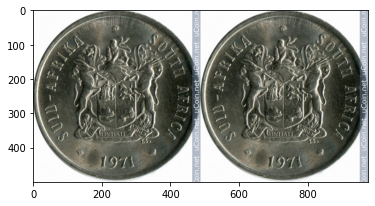

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/012__5 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/028__5 Satang_thailand.jpg', 0.000477483932627365]\**


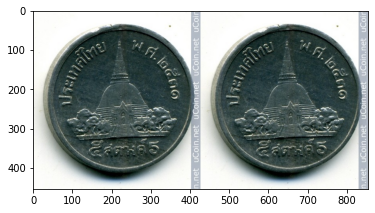

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/016__5 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/027__5 Satang_thailand.jpg', 0.00015913658717181534]\**


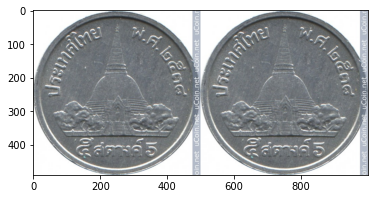

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/016__5 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/008__5 Satang_thailand.jpg', 0.00015913658717181534]\**


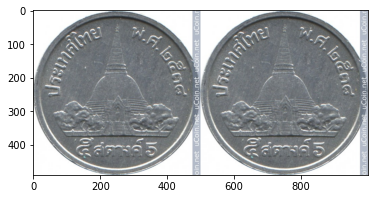

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/016__5 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/007__5 Satang_thailand.jpg', 0.00015913658717181534]\**


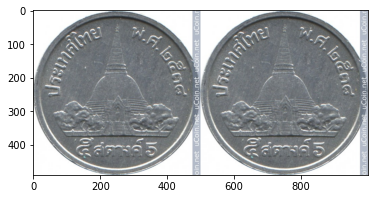

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/019__5 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/198/012__5 Baht_thailand.jpg', 0.09325720369815826]\**


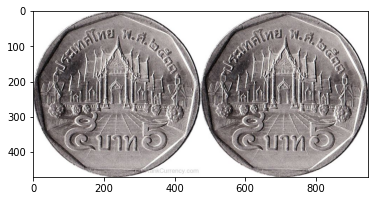

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/006__5 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/005__5 Satang_thailand.jpg', 0.00022821394668426365]\**


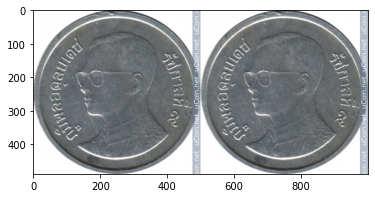

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/006__5 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/032__5 Satang_thailand.jpg', 0.00022821394668426365]\**


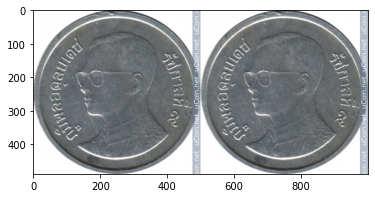

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/006__5 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/192/031__5 Satang_thailand.jpg', 0.00022821394668426365]\**


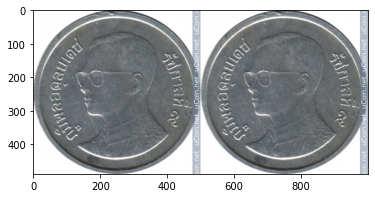

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/018__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/057__1 Jiao_china.jpg', 0.00015551024989690632]\**


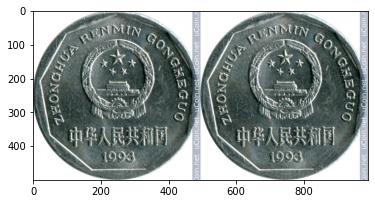

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/018__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/037__1 Jiao_china.jpg', 0.00015551024989690632]\**


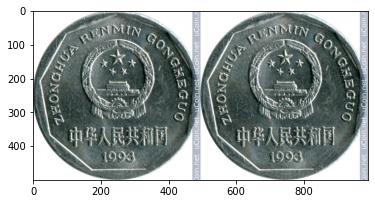

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/018__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/055__1 Jiao_china.jpg', 0.00015551024989690632]\**


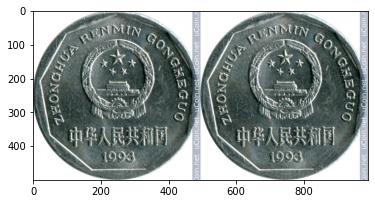

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/018__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/013__1 Jiao_china.jpg', 0.00015551024989690632]\**


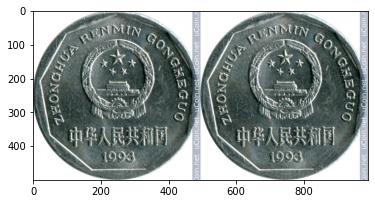

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/018__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/008__1 Jiao_china.jpg', 0.00015551024989690632]\**


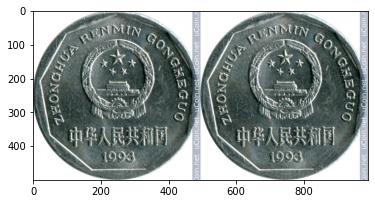

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/004__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/010__1 Jiao_china.jpg', 0.0003542006597854197]\**


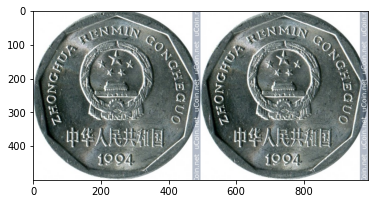

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/053__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/019__1 Jiao_china.jpg', 0.0]\**


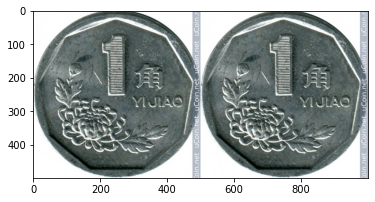

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/053__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/007__1 Jiao_china.jpg', 0.0]\**


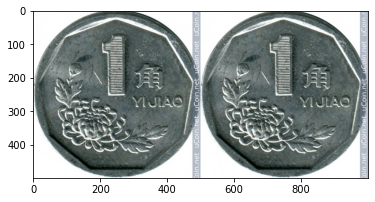

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/053__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/050__1 Jiao_china.jpg', 0.0]\**


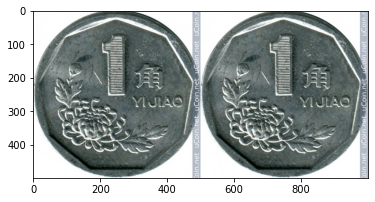

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/053__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/023__1 Jiao_china.jpg', 0.0]\**


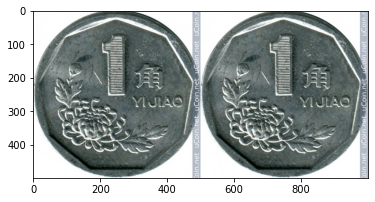

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/053__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/021__1 Jiao_china.jpg', 0.0]\**


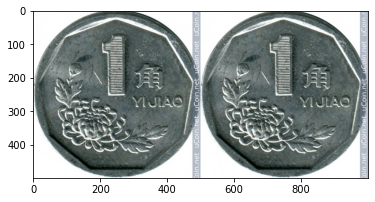

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/035__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/034__1 Jiao_china.jpg', 0.0]\**


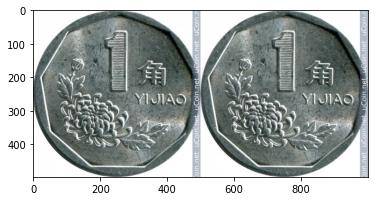

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/029__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/049__1 Jiao_china.jpg', 0.0]\**


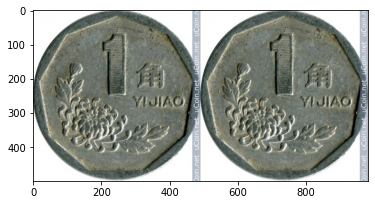

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/005__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/003__1 Jiao_china.jpg', 0.0]\**


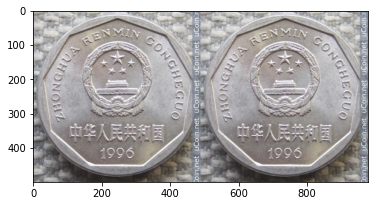

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/005__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/033__1 Jiao_china.jpg', 0.0]\**


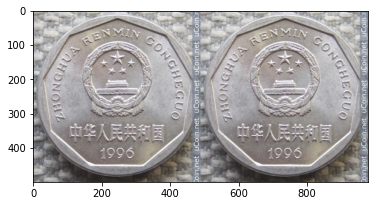

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/052__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/028__1 Jiao_china.jpg', 0.00026610313216224313]\**


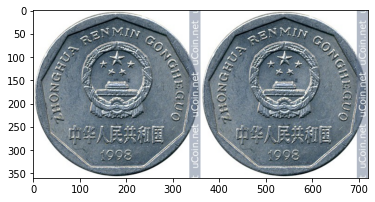

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/052__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/006__1 Jiao_china.jpg', 0.00026610313216224313]\**


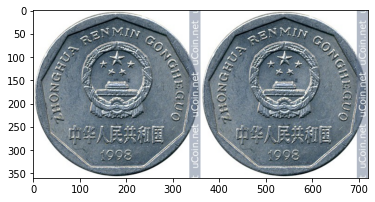

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/052__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/046__1 Jiao_china.jpg', 0.00026610313216224313]\**


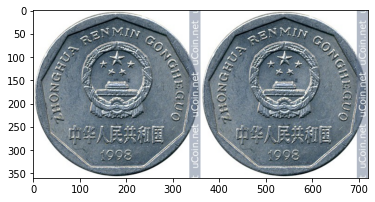

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/054__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/036__1 Jiao_china.jpg', 0.0004773797409143299]\**


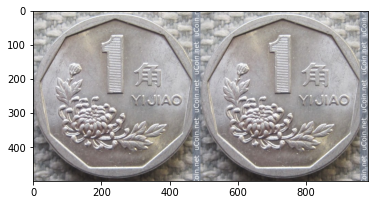

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/054__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/016__1 Jiao_china.jpg', 0.0004773797409143299]\**


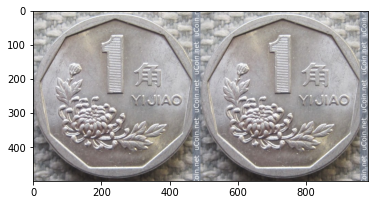

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/054__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/038__1 Jiao_china.jpg', 0.0004773797409143299]\**


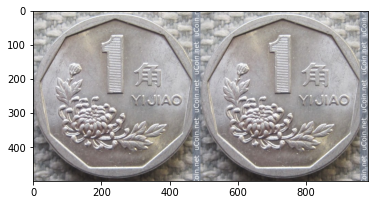

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/060__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/045__1 Jiao_china.jpg', 8.55298203532584e-05]\**


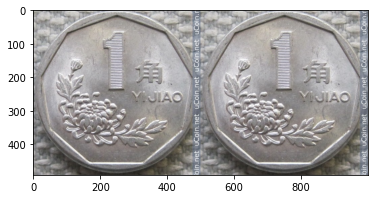

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/048__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/027__1 Jiao_china.jpg', 0.0]\**


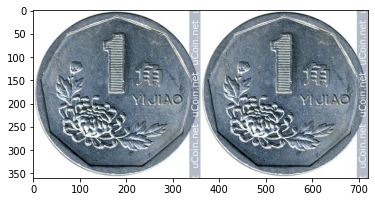

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/048__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/015__1 Jiao_china.jpg', 0.0]\**


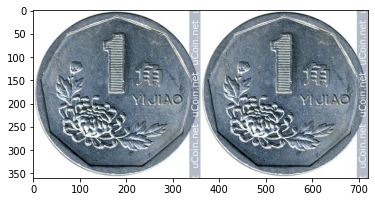

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/048__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/020__1 Jiao_china.jpg', 0.0]\**


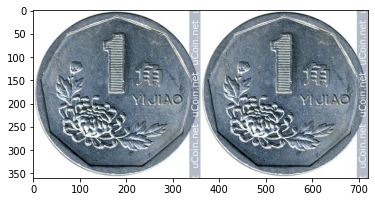

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/059__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/058__1 Jiao_china.jpg', 0.0]\**


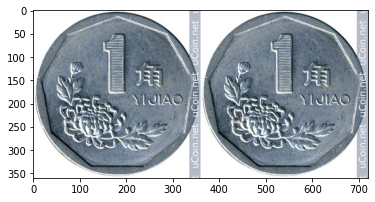

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/026__1 Jiao_china.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/35/041__1 Jiao_china.jpg', 0.0]\**


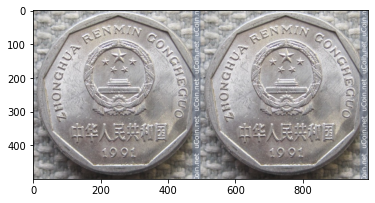

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/195/023__50 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/195/010__50 Satang_thailand.jpg', 0.00012183457874925807]\**


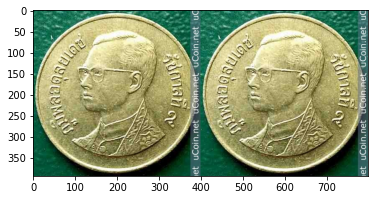

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/195/012__50 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/195/011__50 Satang_thailand.jpg', 0.0]\**


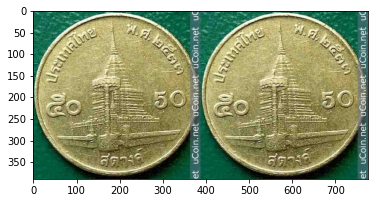

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/195/001__50 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/195/025__50 Satang_thailand.jpg', 0.00013730095815844834]\**


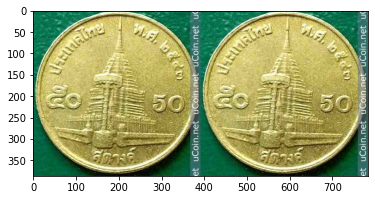

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/195/019__50 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/191/019__1 Satang_thailand.jpg', 0.0]\**


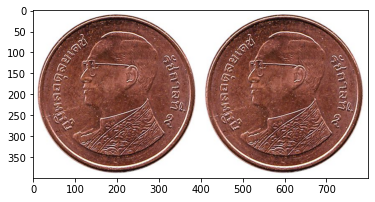

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/195/017__50 Satang_thailand.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/195/021__50 Satang_thailand.jpg', 0.00013989341096021235]\**


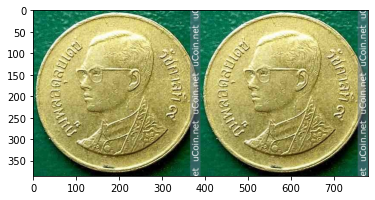

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/002__50 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/024__50 Cents_singapore.jpg', 0.00034421353484503925]\**


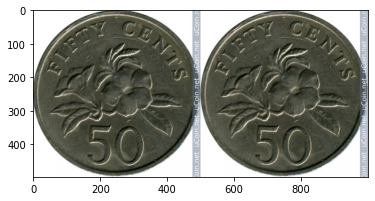

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/002__50 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/019__50 Cents_singapore.jpg', 0.00034421353484503925]\**


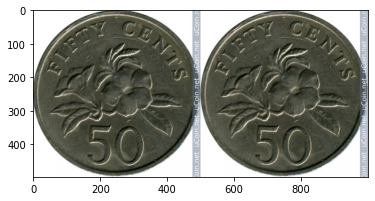

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/002__50 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/031__50 Cents_singapore.jpg', 0.00034421353484503925]\**


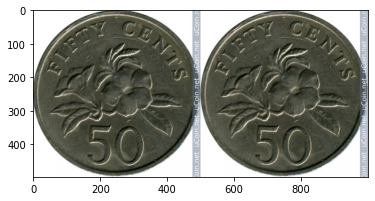

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/009__50 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/016__50 Cents_singapore.jpg', 0.0003570050757844001]\**


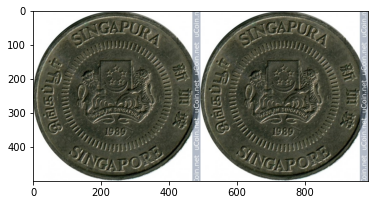

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/009__50 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/030__50 Cents_singapore.jpg', 0.0003570050757844001]\**


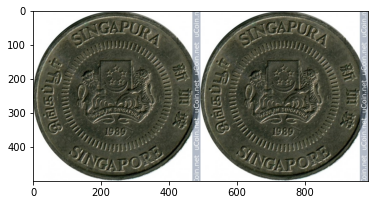

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/009__50 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/007__50 Cents_singapore.jpg', 0.0003570050757844001]\**


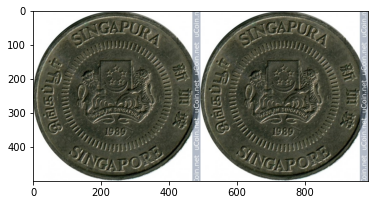

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/009__50 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/018__50 Cents_singapore.jpg', 0.0003570050757844001]\**


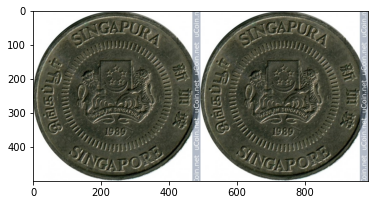

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/009__50 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/035__50 Cents_singapore.jpg', 0.0003570050757844001]\**


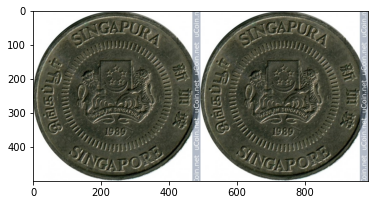

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/034__50 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/025__50 Cents_singapore.jpg', 0.0002486550947651267]\**


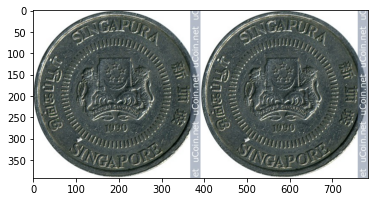

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/023__50 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/008__50 Cents_singapore.jpg', 0.0]\**


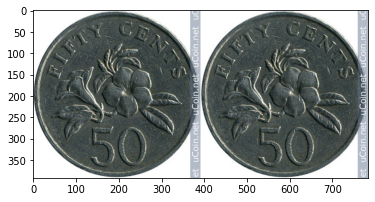

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/023__50 Cents_singapore.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/161/017__50 Cents_singapore.jpg', 0.0]\**


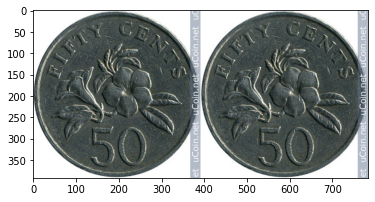

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/102/024__50 Won_south_korea.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/102/012__50 Won_south_korea.jpg', 0.00029690383234992623]\**


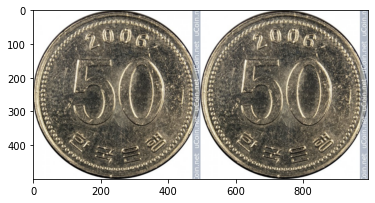

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/102/020__50 Won_south_korea.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/102/019__50 Won_south_korea.jpg', 0.00017194855900015682]\**


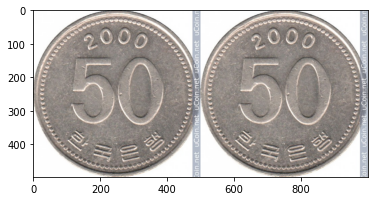

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/102/030__50 Won_south_korea.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/102/001__50 Won_south_korea.jpg', 0.0001064110329025425]\**


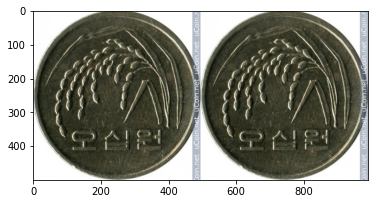

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/011__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/029__5 Forint_hungary.jpg', 0.00014611028018407524]\**


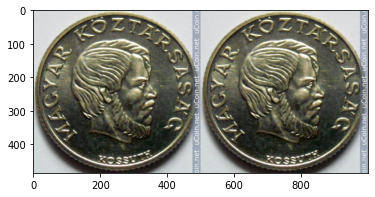

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/011__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/005__5 Forint_hungary.jpg', 0.00014611028018407524]\**


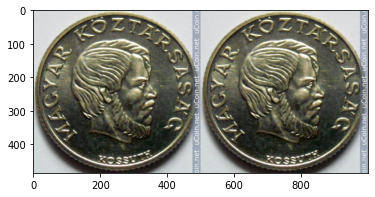

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/011__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/015__5 Forint_hungary.jpg', 0.00014611028018407524]\**


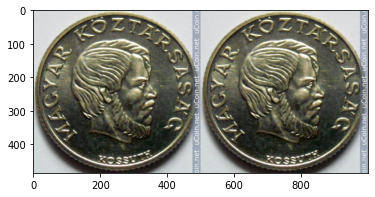

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/011__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/009__5 Forint_hungary.jpg', 0.00014611028018407524]\**


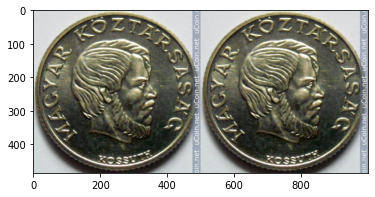

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/011__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/017__5 Forint_hungary.jpg', 0.00014611028018407524]\**


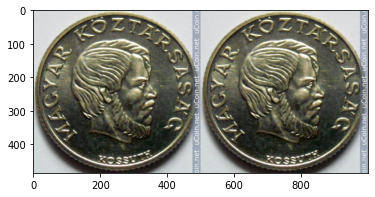

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/011__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/034__5 Forint_hungary.jpg', 0.00014611028018407524]\**


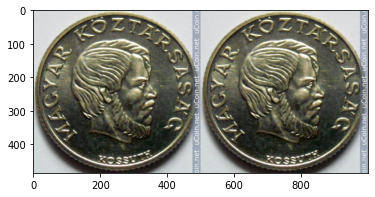

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/011__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/028__5 Forint_hungary.jpg', 0.00014611028018407524]\**


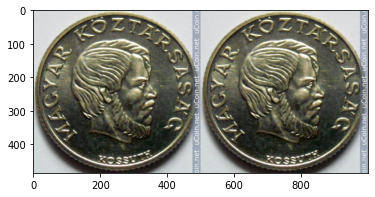

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/011__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/002__5 Forint_hungary.jpg', 0.00014611028018407524]\**


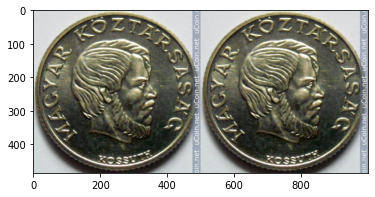

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/011__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/008__5 Forint_hungary.jpg', 0.00014611028018407524]\**


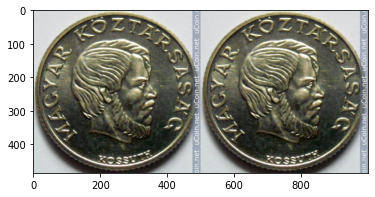

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/023__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/013__5 Forint_hungary.jpg', 0.00029951598844490945]\**


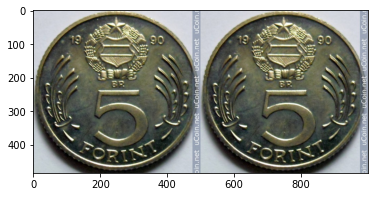

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/023__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/027__5 Forint_hungary.jpg', 0.00029951598844490945]\**


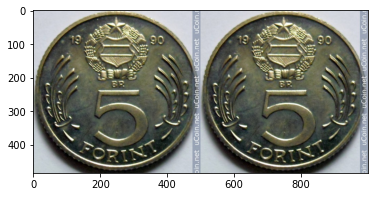

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/023__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/031__5 Forint_hungary.jpg', 0.00029951598844490945]\**


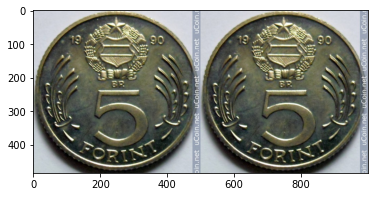

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/023__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/025__5 Forint_hungary.jpg', 0.00029951598844490945]\**


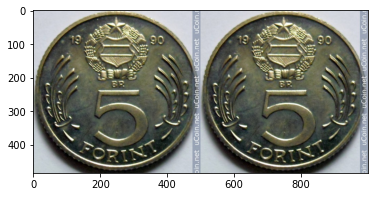

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/023__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/018__5 Forint_hungary.jpg', 0.00029951598844490945]\**


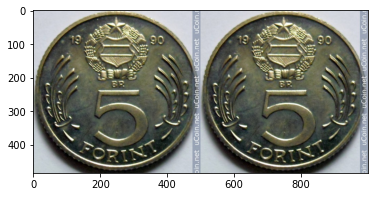

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/023__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/010__5 Forint_hungary.jpg', 0.00029951598844490945]\**


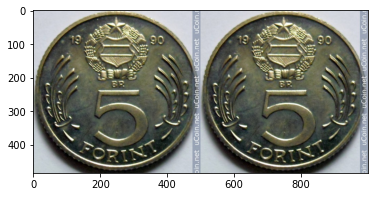

*********************************
**
ref: /Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/023__5 Forint_hungary.jpg 
similars: ['/Users/ugur/Documents/projects/find-similar-images-coin/coin-dataset/coins/data/train/69/006__5 Forint_hungary.jpg', 0.00029951598844490945]\**


KeyboardInterrupt: 

In [12]:
show_similar_items(similar_items)

## delete samples
#### !set simulate=False to remove!

In [ ]:
remove_similar_items(similar_items, simulate=True)